# Setup

## Instructions
1. Download this notebook, and open in it in Jupyer, JupyerLab, VSCode, etc.

In [3]:
!pip install -U pairplots

The first time you import pairplots, we will automatically install Julia (via JuliaUp) and compile pairplots.jl in a self-contained environment. Subsequent imports will be faster.

In [2]:
import pairplots
import numpy as np
import pandas as pd

Detected Jupyter notebook. Loading juliacall extension. Set `PAIRPLOTS_AUTOLOAD_EXTENSIONS=no` to disable.


# Basic interface
The basic way to generate pairplots is the same as corner.py: pass a matrix of samples and a list of labels.

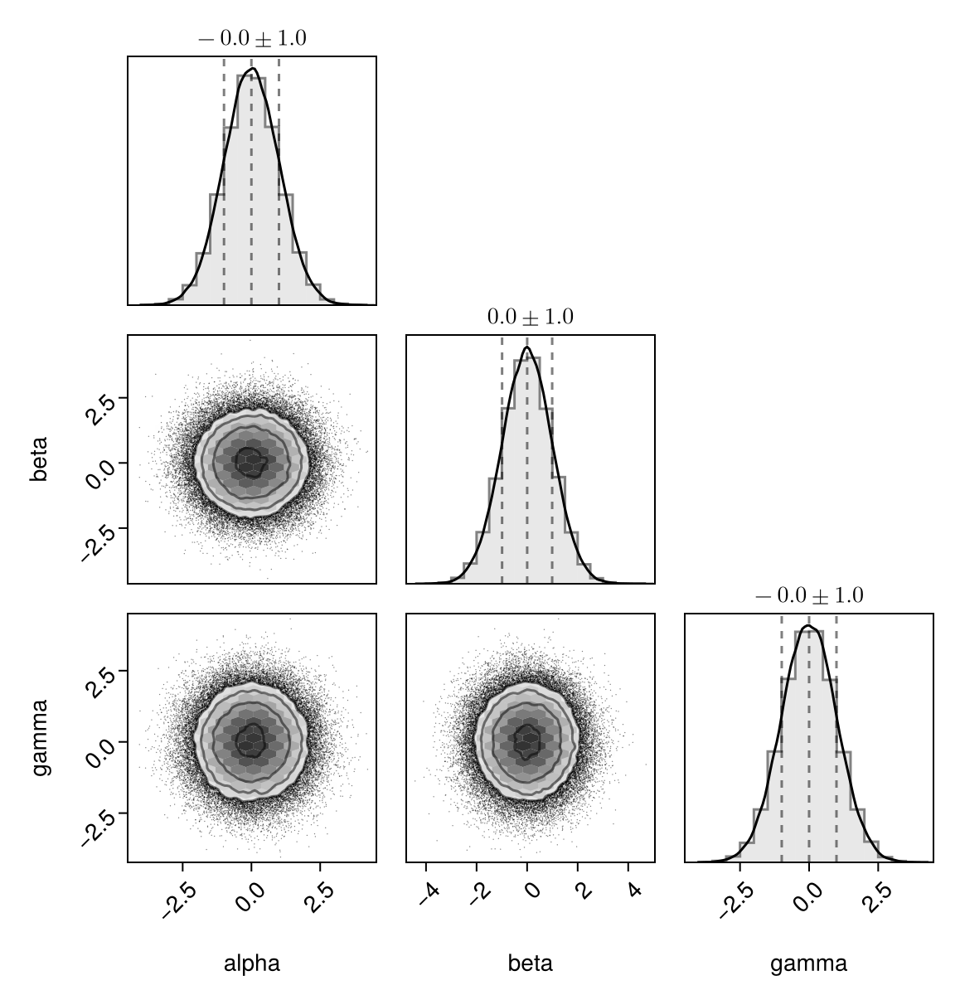

In [3]:
d = np.random.randn(100000,3)
pairplots.pairplot(d, labels=["alpha", "beta", "gamma"])

If you want to use LaTeX in your labels, you can use the `pairplots.latex` function:

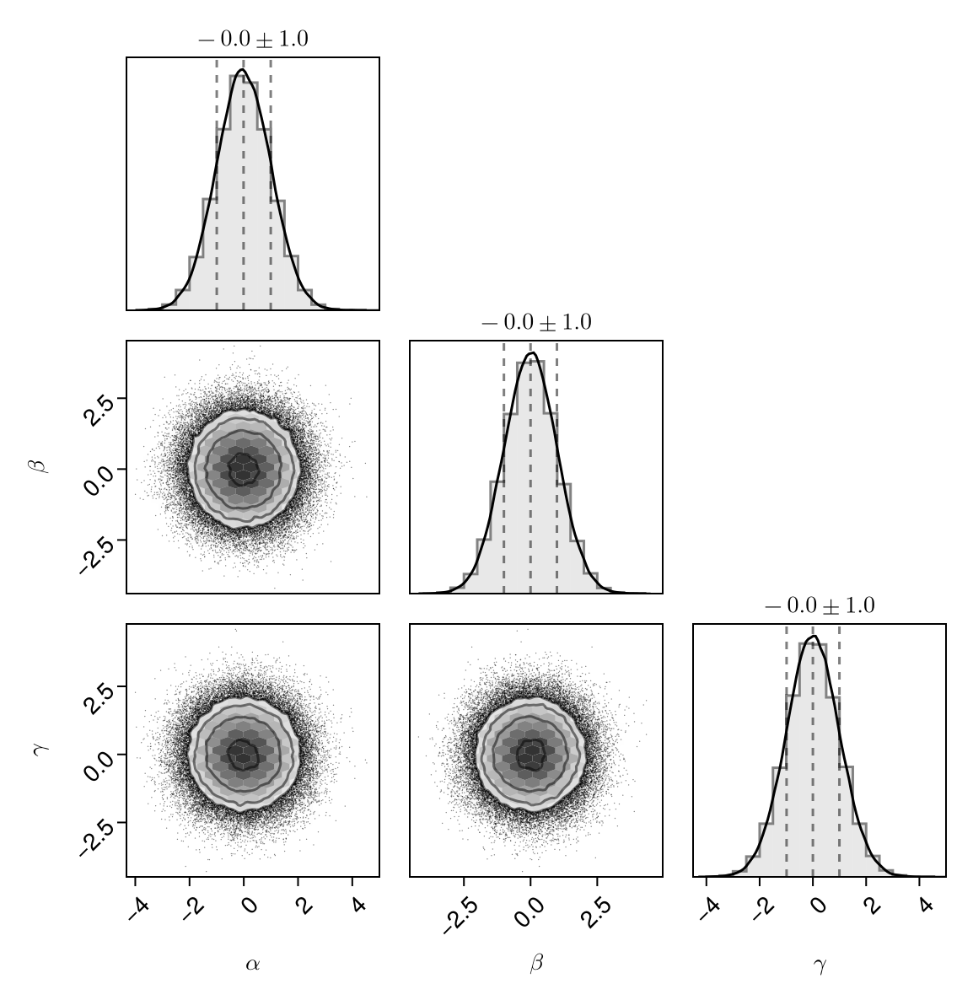

In [4]:
d = np.random.randn(100000,3)
pairplots.pairplot(d, labels=[
    pairplots.latex(r"\alpha"),
    pairplots.latex(r"\beta"),
    pairplots.latex(r"\gamma")
])

You can also use rich text (color, bold, italic, superscript, etc.). Unicode is supported.

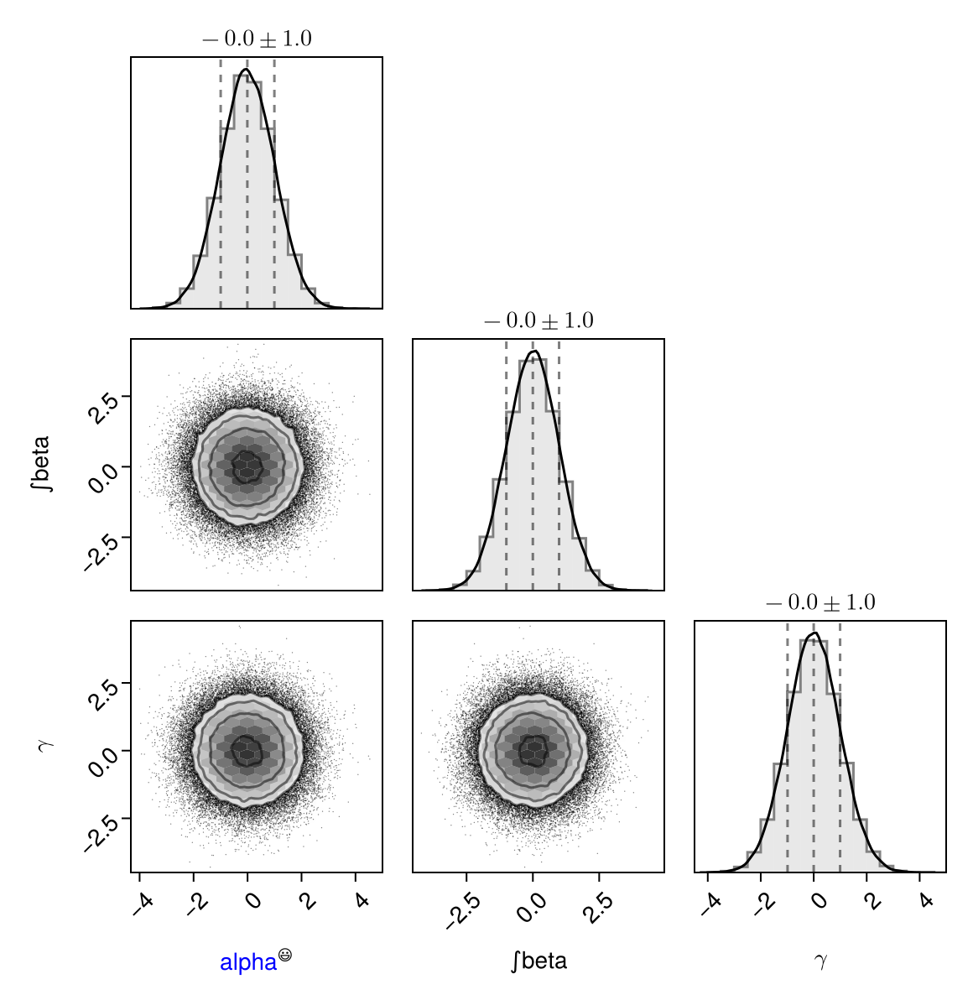

In [12]:
pairplots.pairplot(d, labels=[
    pairplots.rich(
        pairplots.rich("alpha",color='blue'),
        pairplots.superscript("😃")
    ),
    "∫beta",
    pairplots.latex(r"\gamma")
])

## Pandas Interface
Another way to use pairplots is by passing one or more pandas data frames.

In [14]:
N = 10000
alpha = np.append([2*np.random.randn(N//2) + 6], [np.random.randn(N//2)])
beta = np.append([3*np.random.randn(N//2)], [2*np.random.randn(N//2)])
gamma = np.random.randn(N)
delta = 0.00001 * (beta + 0.6*np.random.randn(N))

df = pd.DataFrame({
    'α': alpha,
    'β': beta,
    'γ': gamma,
    'δ': delta
})
df

,α,β,γ,δ
0,1.470974,1.744522,-1.892329,0.000018
1,6.675631,-1.331348,-2.208279,-0.000007
2,4.819102,-5.462685,1.049030,-0.000048
3,8.035462,-6.620624,1.097116,-0.000063
4,4.620897,-3.040051,-0.490688,-0.000035
...,...,...,...,...
9995,0.719466,3.146626,-0.983178,0.000027
9996,-0.364947,0.236755,-0.513942,0.000002
9997,-0.044860,-0.440127,1.062046,-0.000013
9998,0.213266,-0.079923,0.028119,-0.000004


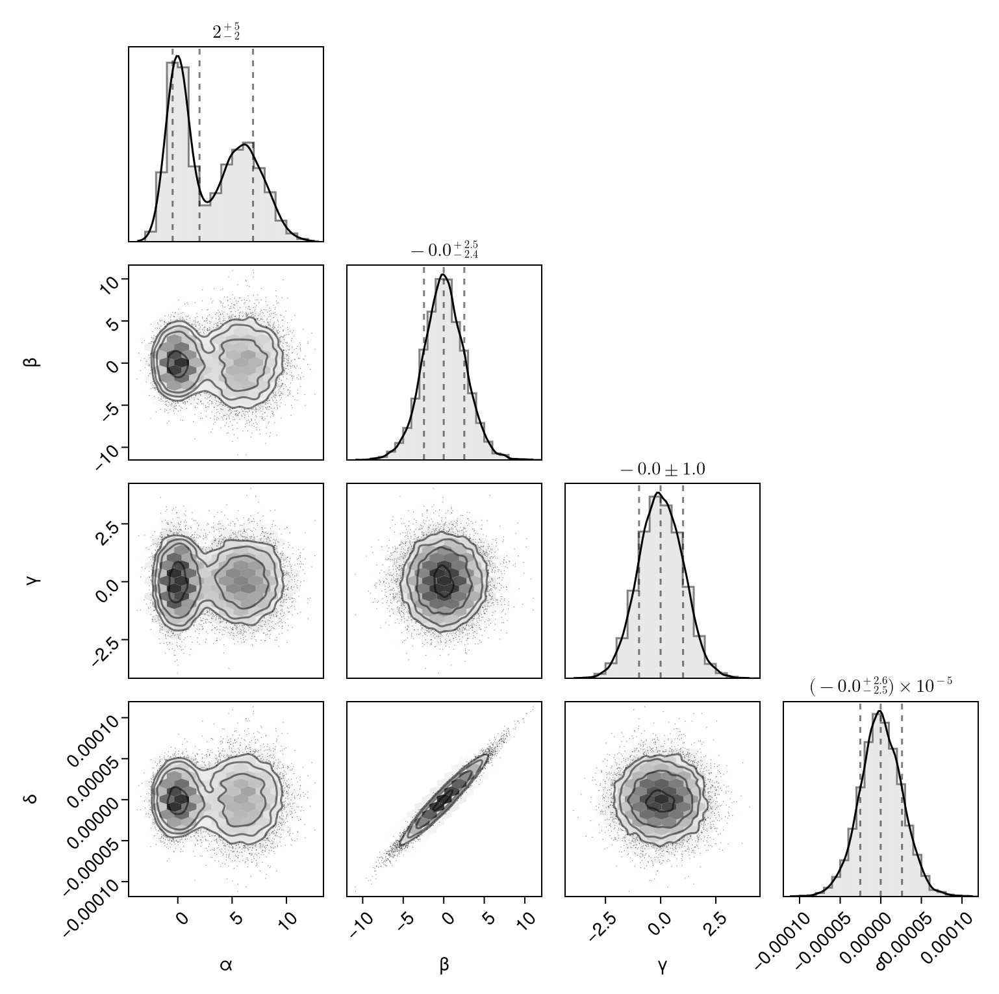

In [15]:
pairplots.pairplot(df)

## Multiple Series

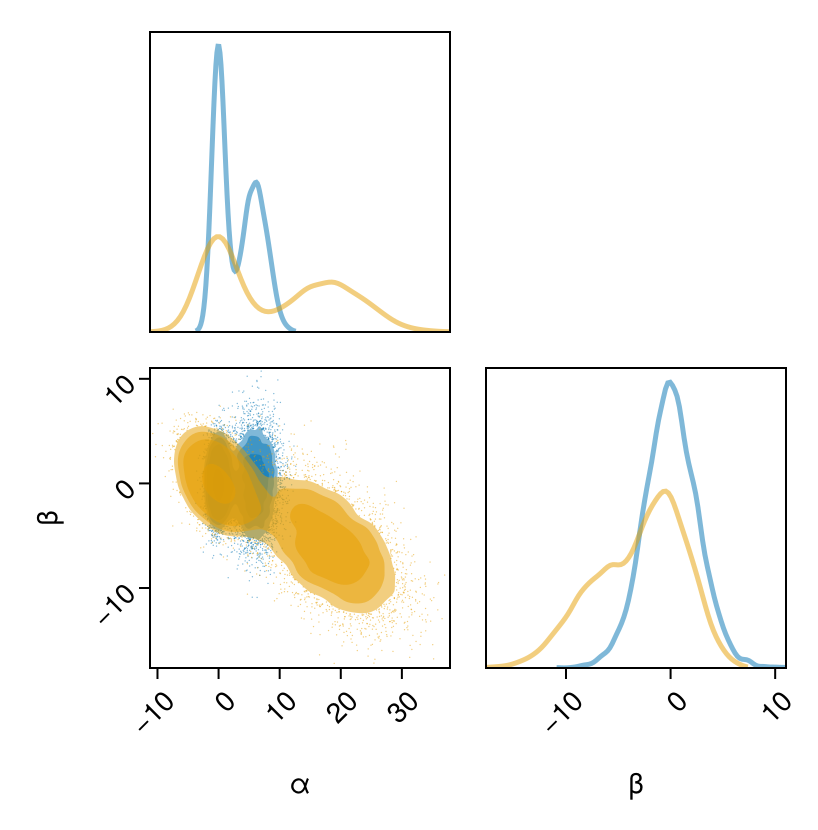

In [20]:
df1 = pd.DataFrame({
    'α': alpha,
    'β': beta,
})

df2 = pd.DataFrame({
    'α': alpha + 2*alpha,
    'β': beta - alpha,
})
pairplots.pairplot(df1, df2)